In [1]:
import pandas as pd
from pathlib import Path
data='/kaggle/input/plantvillage-dataset/color'
paths=[path.parts[-2:] for path in
      Path(data).rglob('*.*')]
df=pd.DataFrame(data=paths,columns=['Class','Images'])
df=df.sort_values('Class',ascending=True)
df.reset_index(drop=True,inplace=True)
df

,Class,Images
0,Apple___Apple_scab,f0d56524-1296-4a54-bafa-9b620baf9f1d___FREC_Sc...
1,Apple___Apple_scab,6643566f-d980-4bdb-88d7-4d3ab3c771fa___FREC_Sc...
2,Apple___Apple_scab,0b1e31fa-cbc0-41ed-9139-c794e6855e82___FREC_Sc...
3,Apple___Apple_scab,1a21aabb-6f74-4644-8d9e-a517568b7e9c___FREC_Sc...
4,Apple___Apple_scab,258ce9eb-2b67-475b-b09c-0bc83b0987f1___FREC_Sc...
...,...,...
54300,Tomato___healthy,c0c7cd05-de91-47b6-9702-823e34e7d332___RS_HL 0...
54301,Tomato___healthy,e6782c6b-bf00-492d-a30e-966fd641b823___RS_HL 9...
54302,Tomato___healthy,e9392a5e-2fac-48c5-a23d-df3aa3f61048___GH_HL L...
54303,Tomato___healthy,1732045f-a451-4325-aa86-717a8cbdaf02___RS_HL 9...


In [2]:
print('Count the number of image datasets')
print("Image Count : {}".format(len(df.Images)))
print("Class Count : {} \n".format(len(df['Class'].value_counts())))
print('Count the number of images in each class')
print(df['Class'].value_counts())

Count the number of image datasets
Image Count : 54305
Class Count : 38 

Count the number of images in each class
Class
Orange___Haunglongbing_(Citrus_greening)              5507
Tomato___Tomato_Yellow_Leaf_Curl_Virus                5357
Soybean___healthy                                     5090
Peach___Bacterial_spot                                2297
Tomato___Bacterial_spot                               2127
Tomato___Late_blight                                  1909
Squash___Powdery_mildew                               1835
Tomato___Septoria_leaf_spot                           1771
Tomato___Spider_mites Two-spotted_spider_mite         1676
Apple___healthy                                       1645
Tomato___healthy                                      1591
Blueberry___healthy                                   1502
Pepper,_bell___healthy                                1478
Tomato___Target_Spot                                  1404
Grape___Esca_(Black_Measles)                         

Text(0, 0.5, 'Count Image')

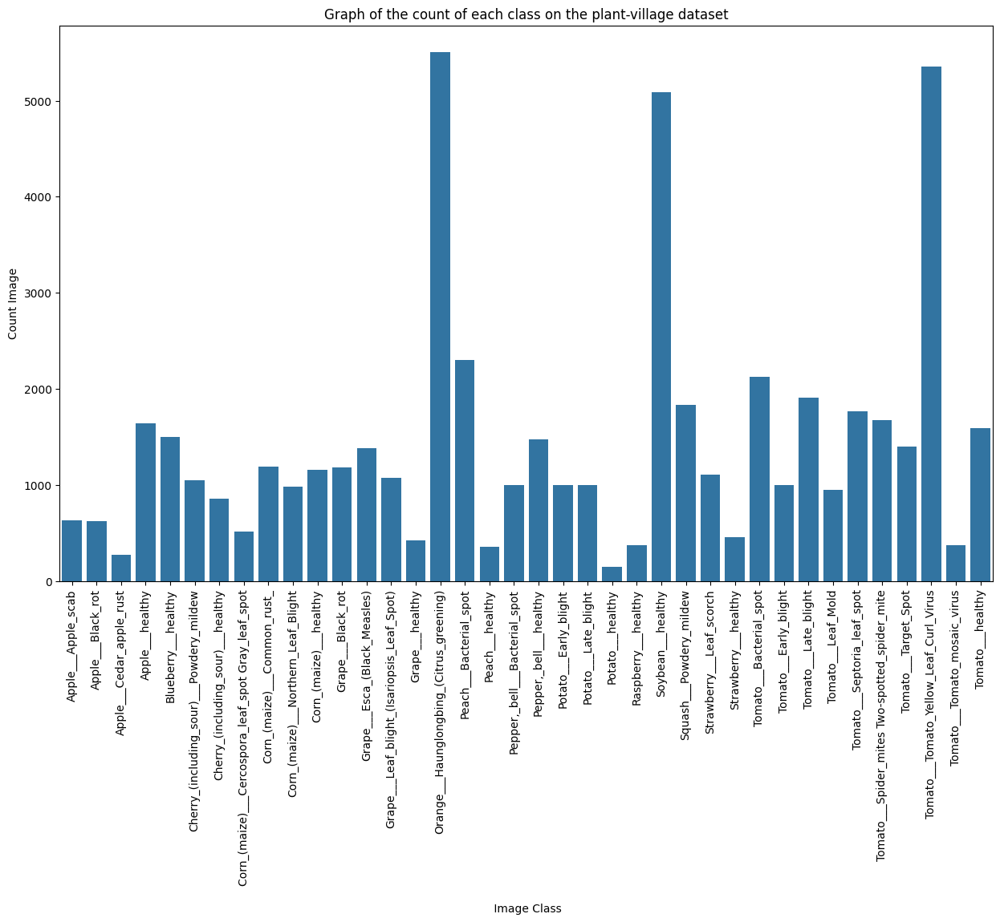

In [3]:
import seaborn as sns
from matplotlib import pyplot as plt

fig, ax = plt.subplots(figsize=(15,9))
sns.countplot(data=df, x='Class')
plt.title('Graph of the count of each class on the plant-village dataset')
plt.xlabel('\n Image Class')
plt.xticks(rotation=90)
plt.ylabel('Count Image')



Class: Apple___Apple_scab
Unique image resolutions (Width x Height):
[[256 256]]
Unique aspect ratios:
[1.]

Class: Apple___Black_rot
Unique image resolutions (Width x Height):
[[256 256]]
Unique aspect ratios:
[1.]

Class: Apple___Cedar_apple_rust
Unique image resolutions (Width x Height):
[[256 256]]
Unique aspect ratios:
[1.]

Class: Apple___healthy
Unique image resolutions (Width x Height):
[[256 256]]
Unique aspect ratios:
[1.]

Class: Blueberry___healthy
Unique image resolutions (Width x Height):
[[256 256]]
Unique aspect ratios:
[1.]

Class: Cherry_(including_sour)___Powdery_mildew
Unique image resolutions (Width x Height):
[[256 256]]
Unique aspect ratios:
[1.]

Class: Cherry_(including_sour)___healthy
Unique image resolutions (Width x Height):
[[256 256]]
Unique aspect ratios:
[1.]

Class: Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot
Unique image resolutions (Width x Height):
[[256 256]]
Unique aspect ratios:
[1.]

Class: Corn_(maize)___Common_rust_
Unique image resolut

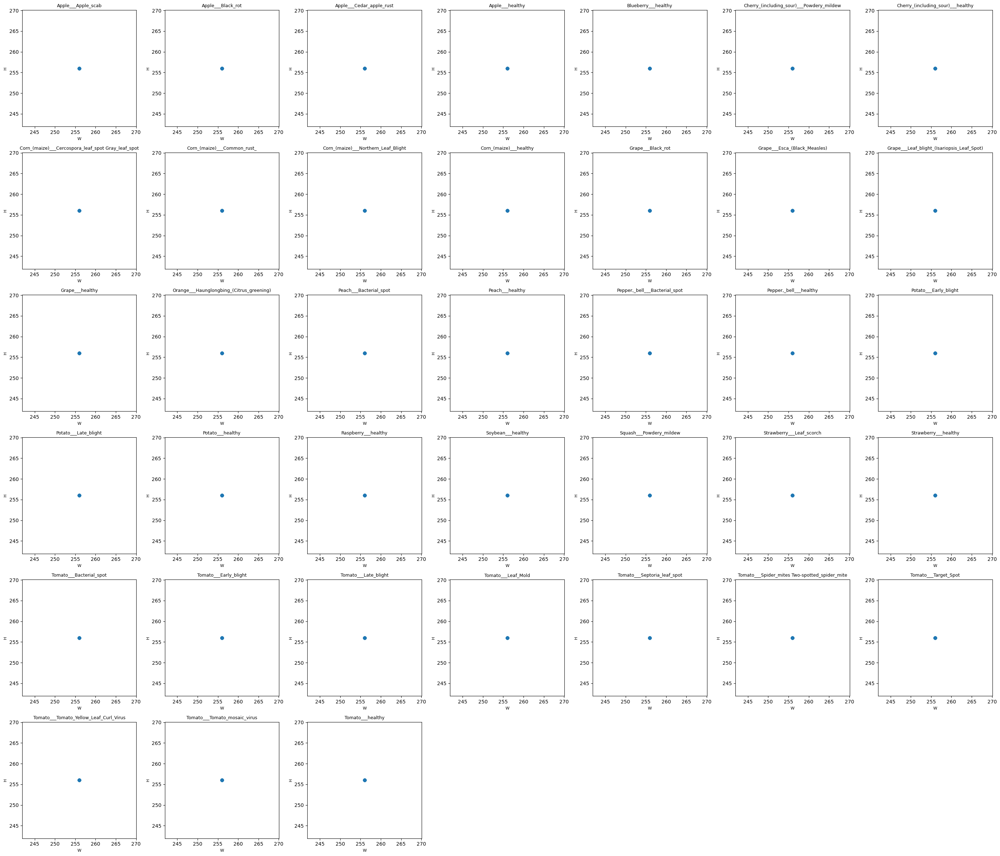

In [4]:
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
import pandas as pd
import random
import math

# Dataset path
data = "/kaggle/input/plantvillage-dataset/color"

# Parameters
SAMPLES_PER_CLASS = 50
COLS = 7

# Get class directories
class_dirs = sorted([p for p in Path(data).iterdir() if p.is_dir()])
rows = math.ceil(len(class_dirs) / COLS)

# Create subplot grid
fig, axes = plt.subplots(rows, COLS, figsize=(4 * COLS, 4 * rows))
axes = axes.flatten()

for ax, class_dir in zip(axes, class_dirs):
    records = []
    images = list(class_dir.iterdir())
    sampled = random.sample(images, min(SAMPLES_PER_CLASS, len(images)))

    # Collect image dimensions
    for img_path in sampled:
        try:
            w, h = Image.open(img_path).size
            records.append((w, h))
        except:
            continue

    if not records:
        continue

    # Create dataframe
    dim_df = pd.DataFrame(records, columns=["Width", "Height"])

    # Plot resolution scatter
    ax.scatter(dim_df["Width"], dim_df["Height"], alpha=0.6)
    ax.set_title(class_dir.name, fontsize=9)
    ax.set_xlabel("W", fontsize=8)
    ax.set_ylabel("H", fontsize=8)

    # ---- PRINT RESOLUTION & ASPECT RATIO ----
    dim_df["Aspect_Ratio"] = dim_df["Width"] / dim_df["Height"]

    print(f"\nClass: {class_dir.name}")
    print("Unique image resolutions (Width x Height):")
    print(dim_df[["Width", "Height"]].drop_duplicates().values)

    print("Unique aspect ratios:")
    print(dim_df["Aspect_Ratio"].round(3).unique())

# Remove unused subplots
for i in range(len(class_dirs), len(axes)):
    fig.delaxes(axes[i])

plt.tight_layout()
plt.show()


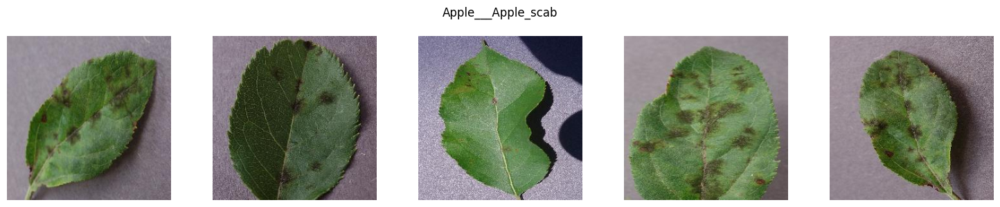

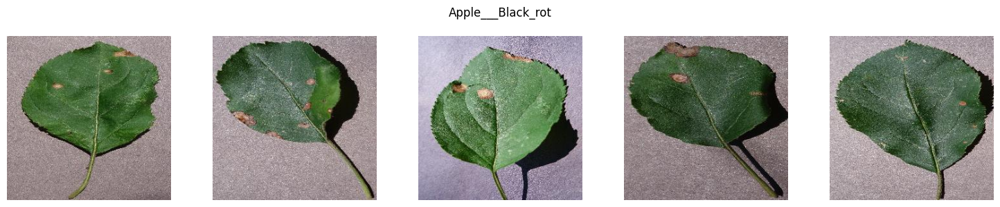

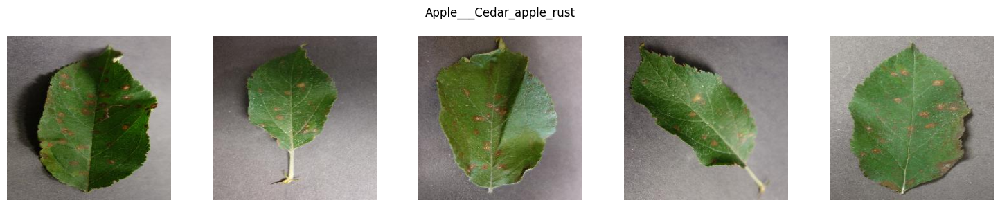

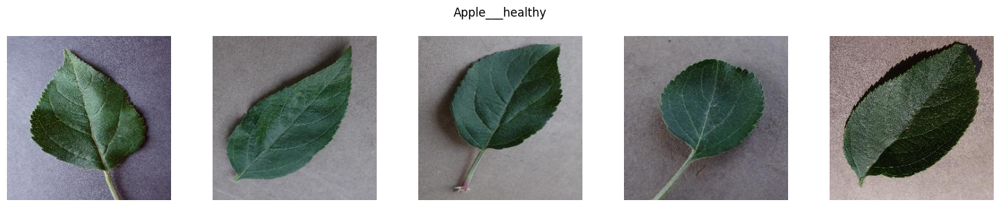

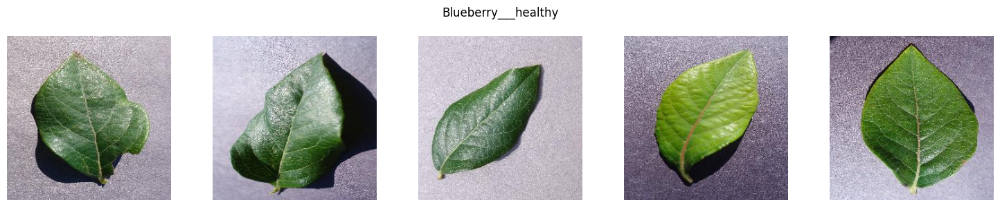

...

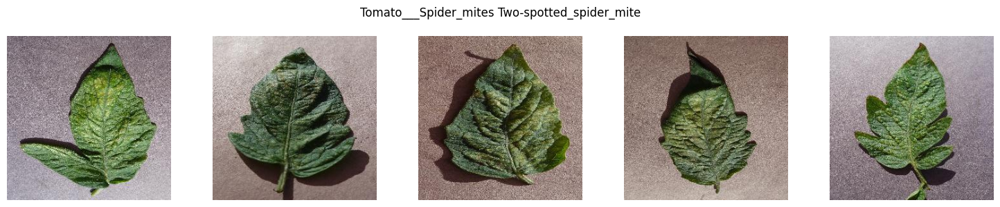

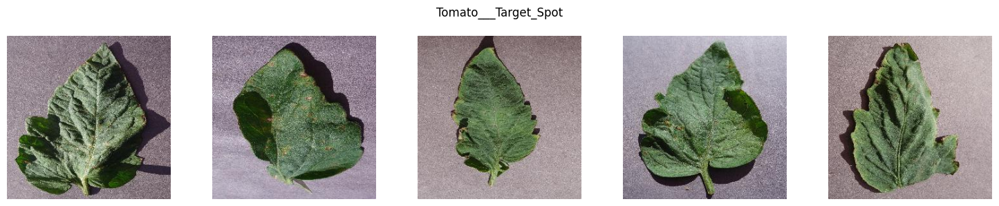

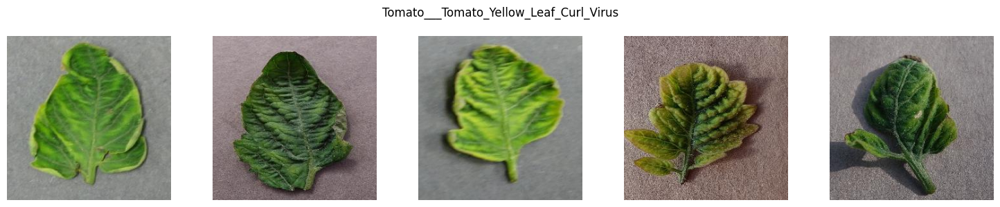

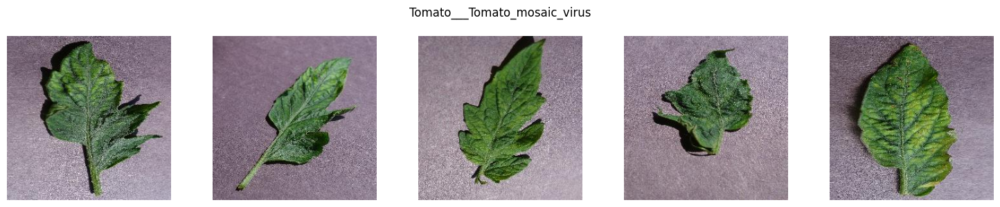

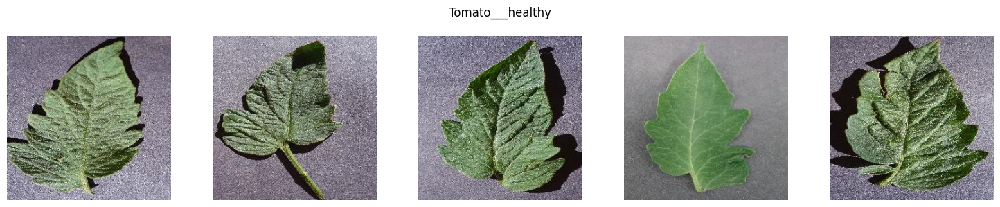

In [5]:
import matplotlib.pyplot as plt
from pathlib import Path
import random
from PIL import Image

data = "/kaggle/input/plantvillage-dataset/color"
IMAGES_PER_CLASS = 5

class_dirs = sorted([p for p in Path(data).iterdir() if p.is_dir()])

for class_dir in class_dirs:
    images = list(class_dir.iterdir())
    if len(images) == 0:
        continue
    
    sampled_images = random.sample(images, min(IMAGES_PER_CLASS, len(images)))

    fig, axes = plt.subplots(1, IMAGES_PER_CLASS, figsize=(15, 3))
    fig.suptitle(class_dir.name, fontsize=12)

    for ax, img_path in zip(axes, sampled_images):
        try:
            img = Image.open(img_path).convert("RGB")
            ax.imshow(img)
            ax.axis("off")
        except:
            ax.axis("off")

    plt.tight_layout()
    plt.show()
